<a href="https://colab.research.google.com/github/ali1810/Deep_Chem/blob/main/Solubility_withPolracharge_density.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install -q condacolab
import condacolab
condacolab.install()

⏬ Downloading https://github.com/jaimergp/miniforge/releases/latest/download/Mambaforge-colab-Linux-x86_64.sh...
📦 Installing...
📌 Adjusting configuration...
🩹 Patching environment...
⏲ Done in 0:00:42
🔁 Restarting kernel...


In [ ]:
!pip install torch


In [ ]:
### Installing RDKIT 
!mamba install -c conda-forge rdkit

Streaming output truncated to the last 5000 lines.
libgfortran-ng           [] (00m:00s) Waiting...
xorg-libice              [] (00m:00s) Waiting...
xorg-xextproto           [] (00m:00s) Waiting...
libopenblas              [] (00m:00s) Waiting...
pandas                   [] (00m:00s) Validating...
libwebp                  [] (00m:00s) Waiting...
matplotlib-base          [] (00m:00s) Waiting...
pixman                   [] (00m:00s) Waiting...
pytz                     [] (00m:00s) Waiting...
tornado                  [] (00m:00s) Waiting...
xorg-libsm               [] (00m:00s) Waiting...
openssl                  [] (00m:00s) Waiting...
cycler                   [] (00m:00s) Waiting...
importlib-metadata       [] (00m:00s) Waiting...
xorg-renderproto         [] (00m:00s) Waiting...
libglib                  [] (00m:00s)      1 MB /      3 MB (564.02 KB/s)
libwebp-base             [] (00m:00s) 
libstdcxx-ng             [] (00m:01s) Decompressing...
liblapack                [] (00m:01s) Waiti

In [ ]:
## Importing Chem libaray from RDkit ...
from rdkit import Chem 

In [ ]:
import numpy as np
import pandas as pd

from rdkit.Chem import AllChem as Chem
from rdkit.Chem import Draw
from rdkit.Chem.Draw import SimilarityMaps

import glob
import imageio
from tqdm import tqdm

import matplotlib.pyplot as plt
# matplotlib.use('agg')

import torch

import os
!pwd

/content


In [ ]:
#%%
import pandas as pd 
# We first process the data into tuples: the first element is the torch tensor
# for the image, and the second is the hydrophobicity/hydrophilicity label. 
# Note that the solubility units are given in lopS (log of molar solubility)

#dir_path = os.path.dirname(os.path.realpath(__file__))
dir_path = '/content/drive/MyDrive/'
data = pd.read_csv(dir_path + '/ESOL_delaney-processed.csv')
med = np.median(data['measured log solubility in mols per litre'])
# If hydrophobic, then label 1, else label 0
print(med)
data['measured log solubility in mols per litre'] = np.where(data['measured log solubility in mols per litre']<=med, 0, 1)
# If hydrophobic, then label 1, else label0
data['measured log solubility in mols per litre']
#print(data['measured log solubility in mols per litre'])

-2.86


0       1
1       0
2       1
3       0
4       1
       ..
1123    1
1124    1
1125    0
1126    0
1127    0
Name: measured log solubility in mols per litre, Length: 1128, dtype: int64

424
424


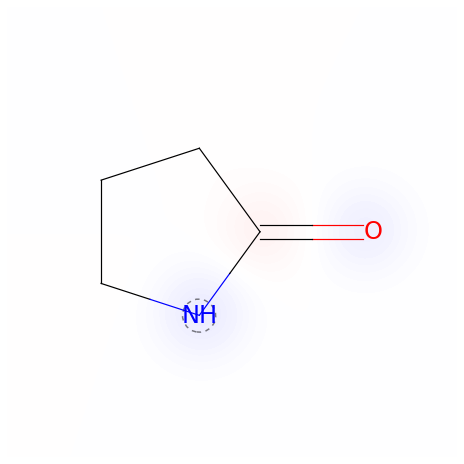

In [ ]:
i = 10
smiles = data['smiles'][i]
category = data['measured log solubility in mols per litre'][i]
trim_margin = 20

mol = Chem.MolFromSmiles(smiles)
Chem.ComputeGasteigerCharges(mol)
contribs = ([float(mol.GetAtomWithIdx(i).GetProp('_GasteigerCharge')) 
                for i in range(mol.GetNumAtoms())])
filename = dir_path +  'figs/mol' + str(i) + '.png'
#print(filename)
fig = SimilarityMaps.GetSimilarityMapFromWeights(mol, contribs,
                                                    scale=150,
                                                    colorMap='bwr', 
                                                    contourLines=1,
                                                    size=(250, 250))

fig.savefig(filename, bbox_inches='tight')
    
im = imageio.imread(filename)
height, width, channels = im.shape
trimmed_height, trimmed_width = (height - 2*trim_margin,width - 2*trim_margin)
    
print(trimmed_height)
print(trimmed_width)

In [ ]:

#%%

# Some general drawing parameters. The idea is to draw the molecules
# without any atomic labels and just focusing on partial charge density
# and the color of the bonds (because the atoms are colored). I would expect
# that molecules with high partial charge densities are soluble in water and 
# low partial charge densities are not soluble in water.

n_mols = data.shape[0]
Draw.DrawingOptions.bondLineWidth = 2
Draw.DrawingOptions.atomLabelFontSize = 1
Draw.DrawingOptions.atomLabelMinFontSize = 1
trim_margin = 20

#%%
def shapeParameters():
    """
    This function calculates the appropriate shape of im_tensor so that we
    can appropriately concat all image matrices to it. We need to be able to 
    preassign the shape correctly
    """

    # margin and other parameters. I first generate and image and get the
    # parameters from there. The only user parameter required is the trim
    # width.
    i = 10
    smiles = data['smiles'][i]
    category = data['measured log solubility in mols per litre'][i]

    mol = Chem.MolFromSmiles(smiles)
    Chem.ComputeGasteigerCharges(mol)
    contribs = ([float(mol.GetAtomWithIdx(i).GetProp('_GasteigerCharge')) 
                for i in range(mol.GetNumAtoms())])
    filename = dir_path + 'figs/mol' + str(i) + '.png'
    fig = SimilarityMaps.GetSimilarityMapFromWeights(mol, contribs,
                                                    scale=150,
                                                    colorMap='bwr', 
                                                    contourLines=1,
                                                    size=(250, 250))
    fig.savefig(filename, bbox_inches='tight')
    print(filename)
    
    im = imageio.imread(filename)
    height, width, channels = im.shape
    trimmed_height, trimmed_width = (height - 2*trim_margin, 
                                             width - 2*trim_margin)
    
    return trimmed_width, trimmed_height




/content/drive/MyDrive/figs/mol10.png


  2%|▏         | 24/1128 [00:15<13:37,  1.35it/s]/usr/local/lib/python3.7/site-packages/rdkit/Chem/Draw/mplCanvas.py:24: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  self._figure = figure(figsize=figsize)
100%|██████████| 1128/1128 [14:06<00:00,  1.33it/s]


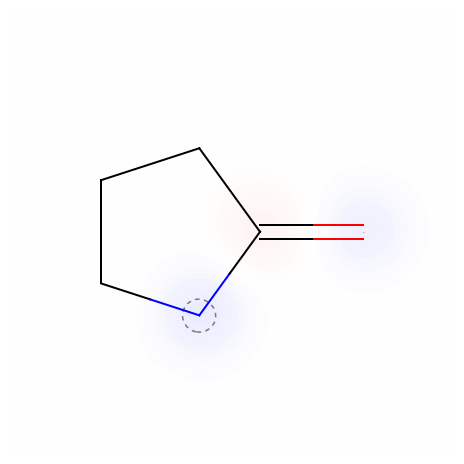

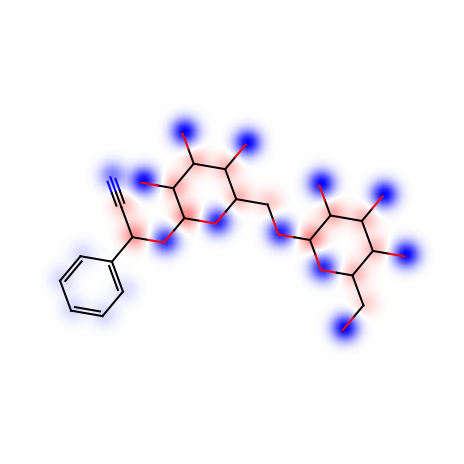

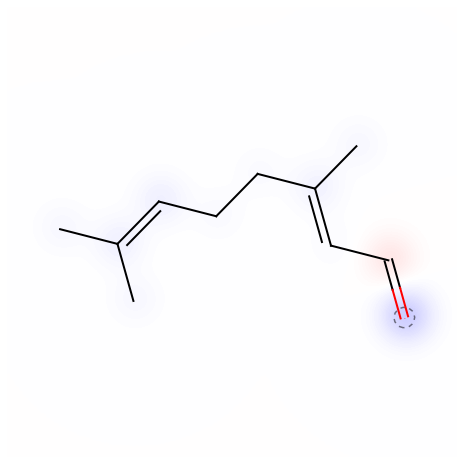

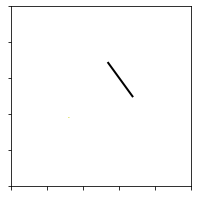

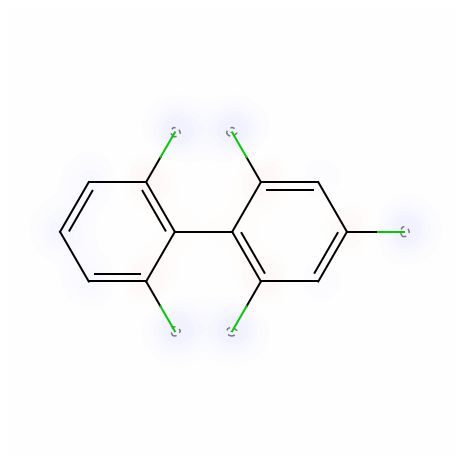

...

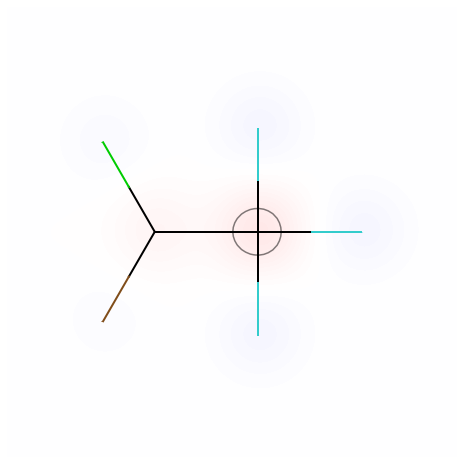

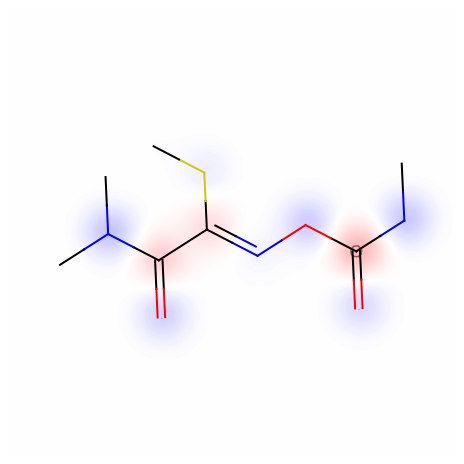

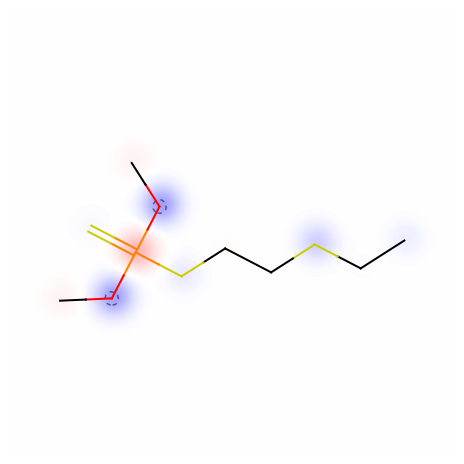

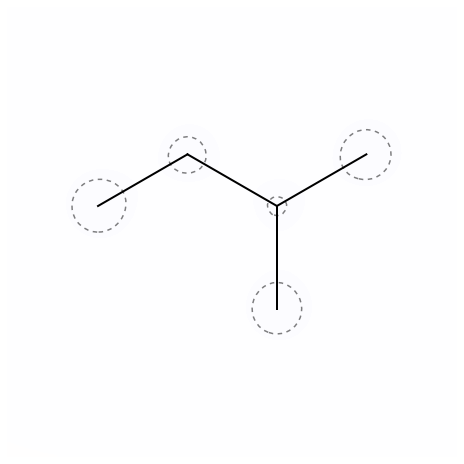

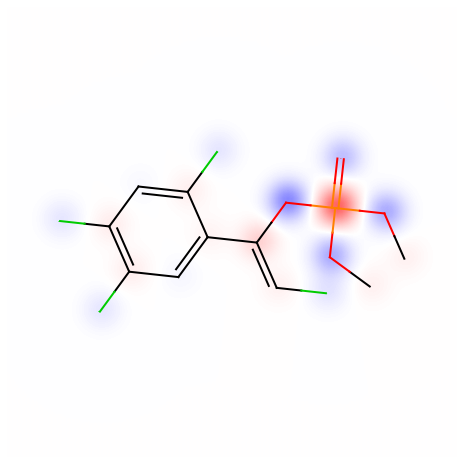

In [ ]:


# Note that instead of saving and then reloading, we could have just done it
# by directly converting the image into the matrix. But there is something about 
# rdkit not fitting the figure inside the canvas.

# I will have to do the figure saving and the generation together because
# some images are being skipped and then the categories wil not match properly
#%%
def molsToImgsToTensor():
    """
    This function takes all the molecules in the dataset, generates images of
    these molecules and daves these as png images
    """
    # We need to preallocate the tensor in memory because append/concat is very
    # slow. We will have a bunch of elements at the end which we will delete
    # before returning the result by maintaining a counter.
    # %matplotlib agg
    trimmed_height, trimmed_width = shapeParameters()
    n_mols = data.shape[0]  
    im_tensor = torch.zeros((n_mols, trimmed_height, trimmed_width, 4),
                            dtype=torch.uint8)
    category_tensor = torch.zeros((n_mols, 1))
    counter = 0
    for i in tqdm(range(data.shape[0])):
        try:
            smiles = data['smiles'][i]
            category = torch.Tensor([data['measured log solubility in mols per litre'][i]]).view(1,-1)
            mol = Chem.MolFromSmiles(smiles)
            Chem.ComputeGasteigerCharges(mol)
            contribs = ([float(mol.GetAtomWithIdx(i).GetProp('_GasteigerCharge')) 
                        for i in range(mol.GetNumAtoms())])
            filename = dir_path + 'figs/mol' + str(i) + '.png'
            fig = SimilarityMaps.GetSimilarityMapFromWeights(mol, contribs,
                                                            scale=150,
                                                            colorMap='bwr', 
                                                            contourLines=1,
                                                            size=(250, 250))
            fig.savefig(filename, bbox_inches='tight')
            
            im = imageio.imread(filename)
            height, width, channels = im.shape
            
            im = im[trim_margin:-trim_margin, trim_margin:-trim_margin, :]
            im = torch.from_numpy(im).view(1, trimmed_width, trimmed_height, 4)
            im_tensor[counter] = im
            # im_tensor = torch.cat((im_tensor, im), dim=0)
            category_tensor[counter] = category
            # category_tensor = torch.cat((category_tensor, category),
                                        # dim=0)
            counter += 1
        except:
            pass
    return (counter, im_tensor.numpy()[:counter], 
                     category_tensor.int().numpy()[:counter])

#%%
counter, im_tensor, category_tensor = molsToImgsToTensor()

np.save(dir_path + '/im_tensor', im_tensor)
np.save(dir_path + '/category_tensor', category_tensor)

# I still need to remove the frame while converting the figures into 
# torch tensors. For this, I can just import the figures and then trim the edges
# by taking image slices. I will have to go in and delete images that look weird

# Note that there are tons of while pixels, but for now I am just going to
# have to do the convolution with it. Maybe this is also a good chance  to 
# see how well the neural network is able to pick out the features when there
# is such a large set of white pixels. I also noticed that there are some
# images that are fully black. I am also going to leave these in to add 'noise'
# to my dataset to see how robust my code is and how good it is at capturing
# stuff.
#%% [markdown]

# At this point we have a tensor that contains all the images. We then take this
# tensor and convert this into a data training pair in the main file

#%%


In [ ]:
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
from matplotlib.backends.backend_agg import FigureCanvasAgg as FigureCanvas
from matplotlib.figure import Figure

from sklearn.model_selection import train_test_split

import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader, TensorDataset
device = torch.device('cuda:0')

import os
#dirpath = os.path.dirname(os.path.realpath(__file__))

from tqdm import tqdm

In [ ]:
from sklearn.model_selection import train_test_split
import numpy as np 
images_arr = np.load(dir_path + '/im_tensor.npy')
labels_arr = np.load(dir_path + '/category_tensor.npy')

images_train, images_test, labels_train, labels_test = train_test_split(
    images_arr, labels_arr, test_size=0.2, random_state=25)

# torch requires images in the format (channels, height, width)
images_train = np.transpose(images_train, axes=(0, 3, 1, 2))
images_test = np.transpose(images_test, axes=(0, 3, 1, 2))

print(np.where(labels_arr)=0)

SyntaxError: ignored

In [ ]:
class imagesDataset(Dataset):

    def __init__(self, images, categories):

        super(imagesDataset, self).__init__()

        self.images = images
        self.categories = categories

    def __len__(self):
        # len() specifies the upper bound for the index of the dataset
        return len(self.categories)

    def __getitem__(self, index):
        # The generator executes the getitem() method to generate a sample
        return self.images[index], self.categories[index]

In [ ]:
train_set = imagesDataset(images_train, labels_train)
test_set = imagesDataset(images_test, labels_test)

batch_size = 25
train_generator = DataLoader(train_set, batch_size=batch_size, shuffle=True)
test_generator = DataLoader(test_set, batch_size=batch_size, shuffle=True)


In [ ]:
class CNN(nn.Module):

    def __init__(self):
        super(CNN, self).__init__()

        self.conv1 = nn.Conv2d(4, 32, (3, 3))
        self.conv2 = nn.Conv2d(32, 64, (3, 3))

        self.fc1 = nn.Linear(104*104*64, 64)
        self.fc2 = nn.Linear(64, 32)
        self.fc3 = nn.Linear(32, 2)

        self.relu = nn.ReLU()
        self.maxpool = nn.MaxPool2d(2)
        self.logsoftmax = nn.LogSoftmax(dim=0)

    def forward(self, x):
        x = self.relu(self.conv1(x))
        x = self.maxpool(x)
        x = self.relu(self.conv2(x))
        x = self.maxpool(x)

        x = x.view(-1, 104*104*64)

        x = self.relu(self.fc1(x))
        x = self.relu(self.fc2(x))
        x = self.fc3(x)

        x = self.logsoftmax(x)

        return x


In [ ]:
!pip uninstall -y mxnet && pip install mxnet-cu90==1.1.0

     |████████████████████████████████| 307.5 MB 49 kB/s 
     |████████████████████████████████| 5.0 MB 42.1 MB/s 
     |████████████████████████████████| 88 kB 6.6 MB/s 
     |████████████████████████████████| 133 kB 64.7 MB/s 
     |████████████████████████████████| 56 kB 3.4 MB/s 
     |████████████████████████████████| 132 kB 70.6 MB/s 
  ERROR: Failed building wheel for numpy
  Running setup.py clean for numpy
  ERROR: Failed cleaning build dir for numpy
Failed to build numpy
  Attempting uninstall: urllib3
    Found existing installation: urllib3 1.26.3
    Uninstalling urllib3-1.26.3:
      Successfully uninstalled urllib3-1.26.3
  Attempting uninstall: idna
    Found existing installation: idna 2.10
    Uninstalling idna-2.10:
      Successfully uninstalled idna-2.10
  Attempting uninstall: chardet
    Found existing installation: chardet 4.0.0
    Uninstalling chardet-4.0.0:
      Successfully uninstalled chardet-4.0.0
  Attempting uninstall: requests
    Found existing insta

In [ ]:
!nvidia-smi

Sun Aug 29 16:47:00 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.57.02    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla K80           Off  | 00000000:00:04.0 Off |                    0 |
| N/A   66C    P8    30W / 149W |      0MiB / 11441MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
#import torch
torch.cuda.is_available()

True

  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 0 = tensor(0.1565)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 1 = tensor(0.1497)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 2 = tensor(0.1469)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 3 = tensor(0.1443)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 4 = tensor(0.1423)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 5 = tensor(0.1409)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 6 = tensor(0.1405)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 7 = tensor(0.1391)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 8 = tensor(0.1385)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 9 = tensor(0.1381)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 10 = tensor(0.1377)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 11 = tensor(0.1364)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 12 = tensor(0.1358)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 13 = tensor(0.1358)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 14 = tensor(0.1352)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 15 = tensor(0.1347)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 16 = tensor(0.1351)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 17 = tensor(0.1340)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 18 = tensor(0.1351)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 19 = tensor(0.1358)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 20 = tensor(0.1348)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 21 = tensor(0.1346)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 22 = tensor(0.1340)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 23 = tensor(0.1336)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 24 = tensor(0.1337)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 25 = tensor(0.1327)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 26 = tensor(0.1328)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 27 = tensor(0.1322)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 28 = tensor(0.1331)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 29 = tensor(0.1324)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 30 = tensor(0.1315)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 31 = tensor(0.1317)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 32 = tensor(0.1317)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 33 = tensor(0.1315)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 34 = tensor(0.1319)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 35 = tensor(0.1313)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 36 = tensor(0.1315)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 37 = tensor(0.1313)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 38 = tensor(0.1312)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 39 = tensor(0.1313)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 40 = tensor(0.1303)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 41 = tensor(0.1304)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 42 = tensor(0.1302)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 43 = tensor(0.1302)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 44 = tensor(0.1302)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 45 = tensor(0.1298)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 46 = tensor(0.1302)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 47 = tensor(0.1301)


  0%|          | 0/31 [00:00<?, ?it/s]

Loss for Epoch 48 = tensor(0.1291)


100%|██████████| 31/31 [00:09<00:00,  3.26it/s]


Loss for Epoch 49 = tensor(0.1309)


CNN(
  (conv1): Conv2d(4, 32, kernel_size=(3, 3), stride=(1, 1))
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (fc1): Linear(in_features=692224, out_features=64, bias=True)
  (fc2): Linear(in_features=64, out_features=32, bias=True)
  (fc3): Linear(in_features=32, out_features=2, bias=True)
  (relu): ReLU()
  (maxpool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (logsoftmax): LogSoftmax(dim=0)
)

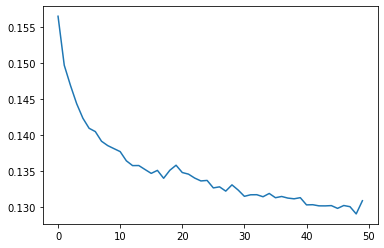

In [ ]:
NUM_EPOCHS = 50
cnn = CNN().to(device)

objective = nn.NLLLoss()
optimizer = optim.SGD(cnn.parameters(), lr=.0001)

#%%
total_loss = torch.zeros(NUM_EPOCHS)
for i in range(NUM_EPOCHS):
    for inp, labels in tqdm(train_generator):
        inp, label = inp.float().to(device), labels.float().to(device)
        out = cnn(inp)

        optimizer.zero_grad()
        # The reshaping is because pytorch needs these dimensions for 
        # NLLLoss to work properly. 
        loss = objective(out.squeeze(), label.long().view(-1))
        loss.backward()
        optimizer.step()
        total_loss[i] += loss.item()/(.8*len(train_generator)*batch_size)
    print('Loss for Epoch', i, '=', total_loss[i])

plt.plot(range(total_loss.shape[0]), total_loss)
f = dir_path + 'cnn_saved.pt'
torch.save(cnn.state_dict(), f)
#%%
f = dir_path + 'cnn_saved.pt'
cnn = CNN()
cnn.load_state_dict(torch.load(f))
cnn.eval()
cnn.to(device)

In [ ]:
def validation():
    errors = 0
    for inp, label in tqdm(test_generator):
        preds = torch.argmax(cnn(inp.float().to(device)), dim=1)
        labels = label.to(device).view(-1)
        errors += torch.sum((preds==labels)*1).item()
    return errors*100/(len(test_generator)*batch_size)
    
#%%
accuracy = validation()
print('accuracy:', accuracy, '%')

100%|██████████| 8/8 [00:01<00:00,  6.67it/s]

accuracy: 71.5 %
